#### Проект 9

# Рынок заведений общественного питания Москвы

### Оглавление: 
1. Описание проекта и данных
2. Изучаем общую информацию о данных
3. Предобработка данных
4. Анализ данных
    * Общие выводы
    
    
5. Шаг 4. Детализируем исследование: открытие кофейни
    * Рекомендации

<a id="description"></a>
###  1. Описание проекта

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Для начала они просят меня — аналитика — подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

Необходимо подготовить лаконичную и информативную презентацию. 

### Описание данных

Доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Файл moscow_places.csv:** 
 - name — название заведения;
 - address — адрес заведения;
 - category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
 - hours — информация о днях и часах работы;
 - lat — широта географической точки, в которой находится заведение;
 - lng — долгота географической точки, в которой находится заведение;
 - rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
 - price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
 - avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
         «Средний счёт: 1000–1500 ₽»;
         «Цена чашки капучино: 130–220 ₽»;
         «Цена бокала пива: 400–600 ₽». и так далее;
 - middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
         Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
         Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
         Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
 - middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
         Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
         Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
         Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
 - chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
        0 — заведение не является сетевым
        1 — заведение является сетевым
 - district — административный район, в котором находится заведение, например Центральный административный округ;
 - seats — количество посадочных мест.

In [1]:
!pip install folium

In [2]:
# импортируем библиотеки: 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
from plotly import graph_objects as go

import folium
from folium import Marker, Map
from folium import Map, Choropleth
from folium.plugins import MarkerCluster
import json

In [3]:
import plotly.io as pio
pio.renderers.default='notebook'

<a id="loading"></a>
## 2. Загрузим данные и изучим общую информацию:

In [4]:
try:
    df = pd.read_csv('moscow_places.csv')
except:
    df = pd.read_csv('/datasets/moscow_places.csv')

In [5]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [6]:
# Кол-во уникальный заведений:
df['name'].nunique()

5614

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


<a id="preprocessing"></a>
## 3. Выполним предобработку данных

In [8]:
df.duplicated().sum()

0

In [9]:
df['category'].unique()
# Кафе и кофейня - это разный формат, поэтому не ОБъединяем их и не считаем НЕявными дубликатами.

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [10]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [11]:
# Посмотрим долю пропусков: 
pd.DataFrame(round(df.isna().mean().sort_values(ascending=False)*100,1)).style.background_gradient('coolwarm')

,0
middle_coffee_cup,93.600000
middle_avg_bill,62.500000
price,60.600000
avg_bill,54.600000
seats,43.000000
hours,6.400000
name,0.000000
category,0.000000
address,0.000000
district,0.000000


#### Создадим столбец street с названиями улиц из столбца с адресом:

In [12]:
# Делим адрес на составляющие разделенные ",":
df[['0','street','2','3','4','5']] = df['address'].str.split(", ",expand=True)
# Удаляем лишние столбцы
df = df.drop(columns = ['0','2','3','4','5'], axis = 1)
df.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица


#### Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
 - логическое значение True — если заведение работает ежедневно и круглосуточно;
 - логическое значение False — в противоположном случае.

In [13]:
df['is_24/7'] = df[df['hours'].apply(lambda x: 'ежедневно, круглосуточно' in str(x))]['hours'] == 'ежедневно, круглосуточно'
df['is_24/7'] = df['is_24/7'].fillna(False)
df.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False


<a id="analysis"></a>
## 4. Анализ данных

### 4.1 Посмотрим какие категории заведений представлены в данных:
Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Посмотрим на распределении заведений по категориям.

In [14]:
types_of_places = df.groupby('category')['category'].count().sort_values(ascending=False)
types_of_places = types_of_places.to_frame(name='values')
types_of_places.reset_index(inplace= True)
types_of_places

,category,values
0,кафе,2378
1,ресторан,2043
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


In [15]:
top_3_share = (100-(types_of_places['values'][3:8].sum() / types_of_places['values'][0:3].sum() *100)).round(1)
print(f'Доля топ-3 заведений в общем кол-ве = {top_3_share} %')

Доля топ-3 заведений в общем кол-ве = 55.9 %


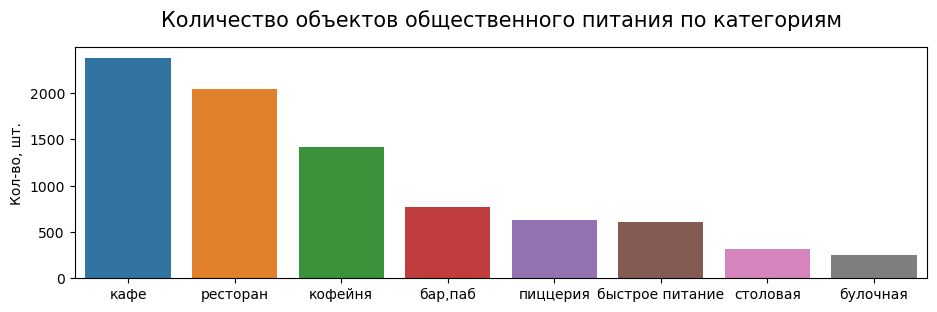

In [16]:
plt.figure(figsize=(11,3))
sns.barplot(data=types_of_places, x='category',y='values')

plt.xticks(rotation=0) # наклон подписи оси x

plt.title('Количество объектов общественного питания по категориям',pad=15, fontsize=15)
plt.xlabel('')
plt.ylabel('Кол-во, шт.')

plt.show()

- Всего в данных представлено 7 типов объектов общ. питания
- Наиболее популярные: Кафе, Ресторан и Кофейня , чья суммарная доля ~ 60%

### 4.2 Посмотрим количество посадочных мест по категориям: рестораны, кофейни, пиццерии, бары и так далее:

In [17]:
df.groupby('category')['seats'].describe().sort_values(by='50%',ascending=False)

,count,mean,std,min,25%,50%,75%,max
category,,,,,,,,
ресторан,1270.0,121.944094,123.757335,0.0,48.00,86.0,150.0,1288.0
"бар,паб",468.0,124.532051,145.011574,0.0,48.00,82.5,150.0,1288.0
кофейня,751.0,111.199734,127.837772,0.0,40.00,80.0,144.0,1288.0
столовая,164.0,99.750000,122.951453,0.0,40.00,75.5,117.0,1200.0
быстрое питание,349.0,98.891117,106.611739,0.0,28.00,65.0,140.0,1040.0
кафе,1218.0,97.512315,117.985084,0.0,35.25,60.0,120.0,1288.0
пиццерия,427.0,94.496487,112.282703,0.0,30.00,55.0,120.0,1288.0
булочная,148.0,89.385135,97.685844,0.0,25.00,50.0,120.0,625.0


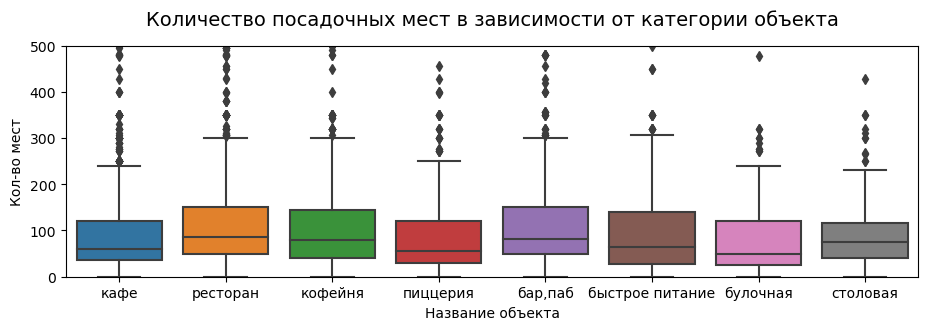

In [18]:
plt.figure(figsize=(11,3))
sns.boxplot(x='category', y='seats', data=df)
plt.ylim(0,500)
plt.title('Количество посадочных мест в зависимости от категории объекта', pad=15, fontsize=14)
plt.xlabel('Название объекта')
plt.ylabel('Кол-во мест')

plt.show()

 - Медианный разброс посадочных мест от 50 в булочных до 86 в ресторанах
 - ТОП-3 по кол-ву: Ресторан 86, Бар/Паб 82.5 и Кофейня 80

### 4.3 Рассмотрим соотношение сетевых и несетевых заведений: 

In [19]:
t = df.groupby('chain',as_index=False)['chain'].count()
t

,chain
0,5201
1,3205


In [20]:
fig = go.Figure(data=[go.Pie(labels=t.index, values=t['chain'])])
fig.update_layout(title_text='Cоотношение сетевых и несетевых заведений', title_x=0.5, # Заголовок и его положение
                 autosize=False, width=800, height=400, # изменение размера графика
                 )
fig.show() 

- Доля сетевых заведений 38.1 %, против 61,9 % у Не сетевых

### 4.4 Посмотрим какие категории заведений чаще являются сетевыми:

In [21]:
chain_categories = df.groupby('category',as_index=False)[['category','chain']].mean() \
    .round(2).sort_values(by='chain',ascending=False) \
    .reset_index(drop=True)
chain_categories

,category,chain
0,булочная,0.61
1,пиццерия,0.52
2,кофейня,0.51
3,быстрое питание,0.38
4,ресторан,0.36
5,кафе,0.33
6,столовая,0.28
7,"бар,паб",0.22


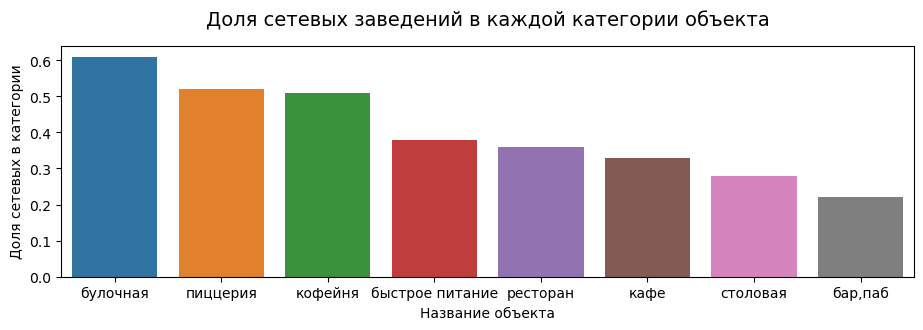

In [22]:
plt.figure(figsize=(11,3))
sns.barplot(data=chain_categories, x='category',y='chain')

plt.xticks(rotation=0) # наклон подписи оси x

plt.title('Доля сетевых заведений в каждой категории объекта',pad=15, fontsize=14)
plt.xlabel('Название объекта')
plt.ylabel('Доля сетевых в категории')

plt.show()

- Чаще всего сетевыми являются булочные 60%
- Около половины Пиццерии - 52 % и Кофейни - 51%  

### 4.5 Сгруппируем данные по названиям заведений и найдем топ-15 популярных сетей в Москве: 
(Под популярностью понимается количество заведений этой сети в регионе) 

In [23]:
top_fifteen_places = df['name'].value_counts().head(15)
top_fifteen_places

Кафе                                   189
Шоколадница                            120
Домино'с Пицца                          76
Додо Пицца                              74
One Price Coffee                        71
Яндекс Лавка                            69
Cofix                                   65
Prime                                   50
Хинкальная                              44
Шаурма                                  43
КОФЕПОРТ                                42
Кулинарная лавка братьев Караваевых     39
Теремок                                 38
Чайхана                                 37
Ресторан                                34
Name: name, dtype: int64

In [24]:
# Посмотрим внутри 
df[df['name'].isin(top_fifteen_places.index)].groupby('name').mean()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats,is_24/7
name,,,,,,,,
Cofix,55.755808,37.607951,4.075385,NaN,68.571429,1.0,105.750000,0.030769
One Price Coffee,55.745338,37.599191,4.064789,NaN,95.000000,1.0,140.711538,0.014085
Prime,55.750551,37.603623,4.116000,362.000000,NaN,1.0,126.515152,0.000000
Додо Пицца,55.749049,37.619474,4.286486,388.263889,NaN,1.0,94.596774,0.000000
Домино'с Пицца,55.745032,37.607741,4.169737,503.571429,NaN,1.0,52.819672,0.000000
КОФЕПОРТ,55.763334,37.558071,4.147619,NaN,95.833333,1.0,121.478261,0.000000
Кафе,55.753527,37.611354,3.880952,3816.000000,NaN,0.0,64.067568,0.100529
Кулинарная лавка братьев Караваевых,55.760594,37.603878,4.394872,460.689655,NaN,1.0,102.074074,0.000000
Ресторан,55.763167,37.613732,4.314706,NaN,NaN,0.0,132.931034,0.029412


In [25]:
# Добавим столбец для идентификации топ 15:
df['is_top_fifteen'] = df['name'].isin(top_fifteen_places.index)

In [26]:
# Сравним топ 15 с остальными:
df.groupby('is_top_fifteen')[['rating','middle_avg_bill','middle_coffee_cup','chain','seats','is_24/7']].mean()

,rating,middle_avg_bill,middle_coffee_cup,chain,seats,is_24/7
is_top_fifteen,,,,,,
False,4.249305,986.807772,175.236318,0.334457,109.323036,0.087525
True,4.084662,611.095436,173.165414,0.731584,102.340872,0.081736


- В топ 15 в основном Кафе, Пиццерии и рестораны быстрого питания
- В сетевых ~ на 35% Ниже средний чек и немного ниже удовлетворенность клиентов: Рейтинг 4.08 против 4.25

### 4.6 Посмотрим какие административные районы Москвы присутствуют в датасете:

In [27]:
district_category_name = df.pivot_table(index = 'district', columns = 'category' , values = 'name', aggfunc='count')
district_category_name

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40
Западный административный округ,50,37,62,239,150,71,218,24
Северный административный округ,68,39,58,235,193,77,189,41
Северо-Восточный административный округ,63,28,82,269,159,68,182,40
Северо-Западный административный округ,23,12,30,115,62,40,109,18
Центральный административный округ,364,50,87,464,428,113,670,66
Юго-Восточный административный округ,38,13,67,282,89,55,145,25
Юго-Западный административный округ,38,27,61,238,96,64,168,17
Южный административный округ,68,25,85,264,131,73,202,44


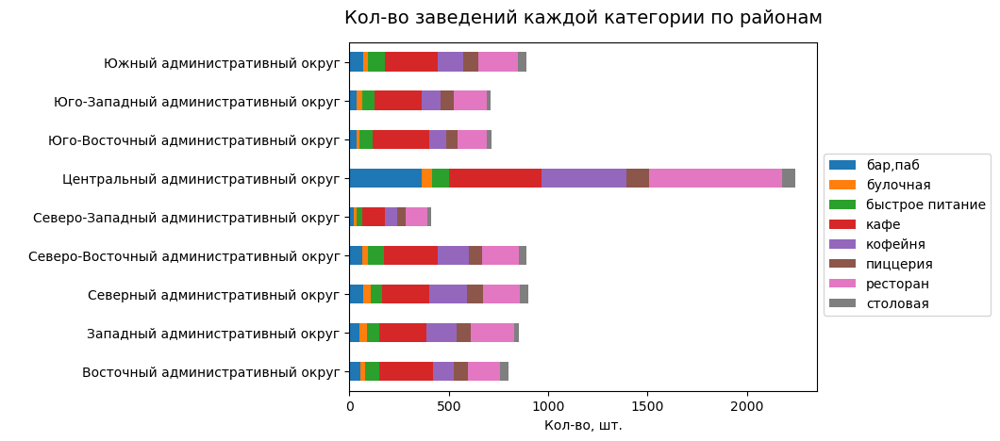

In [28]:
district_category_name.plot(kind = 'barh', stacked = True)

plt.legend(bbox_to_anchor=(1, 0.7)) # местоположение легенды

plt.title('Кол-во заведений каждой категории по районам', pad=15, fontsize=14)
plt.xlabel('Кол-во, шт.')
plt.ylabel(' ')


plt.show()

- Представлено 9 округов из 10ти (Кроме Зеленоградского АО)
- Самый популярный - Центральный округ
- Следом Северый, Южный и Северо-Восточный соответственно

### 4.7 Посмотрим распределение средних рейтингов по категориям заведений: 
Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [29]:
avg_category_rating = (
    df.groupby('category',as_index=False)['rating'].mean().round(2)
    .sort_values(by='rating', ascending=False)
    .reset_index(drop=True)
)
avg_category_rating

,category,rating
0,"бар,паб",4.39
1,пиццерия,4.30
2,ресторан,4.29
3,кофейня,4.28
4,булочная,4.27
5,столовая,4.21
6,кафе,4.12
7,быстрое питание,4.05


In [30]:
avg_rating = round(df['rating'].mean(),2)
print(f'Срейдний рейтинг по всем заведениям = {avg_rating}')

Срейдний рейтинг по всем заведениям = 4.23


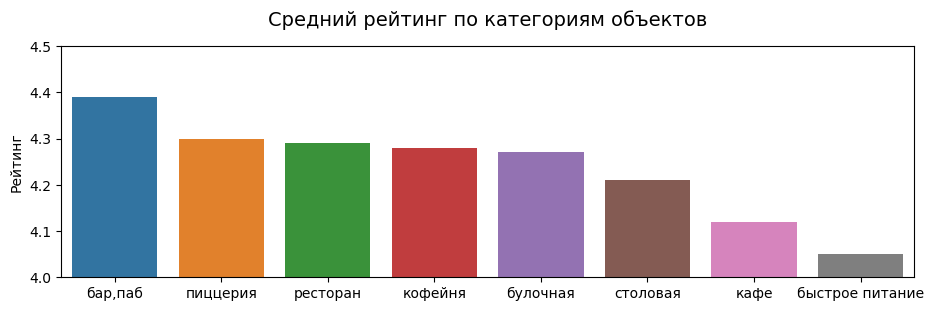

In [31]:
plt.figure(figsize=(11,3))
sns.barplot(data=avg_category_rating, x='category',y='rating')

plt.xticks(rotation=0) # наклон подписи оси x
plt.ylim(4,4.5)

plt.title('Средний рейтинг по категориям объектов',pad=15, fontsize=14)
plt.xlabel('')
plt.ylabel('Рейтинг')

plt.show()

- Средний рейтинг по категориям различается НЕ сильно. Диапазон от 4.05 до 4.4
- Лидируют Бары и Пабы, далее Примерно одинаковы Рестораны, пиццерии **Кофейни** и Булочные
- Кафе и быстрое питание, так популярные у сетей - внизу рейтинга 

### 4.8 Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района: 
Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson 

In [32]:
# читаем файл и сохраняем в переменной
with open('admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

In [33]:
# загружаем JSON-файл с границами округов Москвы
# state_geo = 'admin_level_geomap.geojson'
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

In [34]:
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

### 4.9 Отобразим все заведения датасета на карте с помощью кластеров средствами биб-ки folium:

In [35]:
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

In [36]:
# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

In [37]:
# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

### 4.10 Найдем топ-15 улиц по количеству заведений: 
- Построим график распределения количества заведений и их категорий по этим улицам. 

In [38]:
top_fifteen_streets = (
    df.groupby('street',as_index=False)['category'].count()
    .sort_values(by='category',ascending=False).head(15)
)
top_fifteen_streets

,street,category
1090,проспект Мира,184
773,Профсоюзная улица,122
1087,проспект Вернадского,108
525,Ленинский проспект,107
523,Ленинградский проспект,95
373,Дмитровское шоссе,88
455,Каширское шоссе,77
298,Варшавское шоссе,76
524,Ленинградское шоссе,70
550,МКАД,65


In [39]:
top_fifteen_streets_df= df[df['street'].isin(top_fifteen_streets['street'])]
top_fifteen_streets_df.head(2)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,is_top_fifteen
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0,Дмитровское шоссе,False,False
12,Заправка,кафе,"Москва, МКАД, 80-й километр, 1",Северный административный округ,вт-сб 09:00–18:00,55.899938,37.517958,4.3,средние,Средний счёт:330 ₽,330.0,NaN,0,NaN,МКАД,False,False


In [40]:
tfs_pivot = (
    top_fifteen_streets_df.pivot_table(index = 'street', columns = 'category' , values = 'name', aggfunc='count')
    .sort_values(by='кафе')
)
tfs_pivot

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
street,,,,,,,,
Пятницкая улица,9.0,3.0,2.0,7.0,6.0,3.0,18.0,NaN
Ленинградский проспект,15.0,4.0,2.0,12.0,25.0,9.0,25.0,3.0
Ленинградское шоссе,5.0,2.0,5.0,13.0,13.0,3.0,26.0,3.0
Кутузовский проспект,2.0,1.0,2.0,14.0,13.0,3.0,16.0,3.0
улица Вавилова,2.0,2.0,11.0,15.0,10.0,3.0,12.0,NaN
Варшавское шоссе,6.0,NaN,7.0,18.0,14.0,4.0,20.0,7.0
Каширское шоссе,2.0,NaN,10.0,20.0,16.0,5.0,19.0,5.0
улица Миклухо-Маклая,3.0,NaN,4.0,21.0,4.0,2.0,15.0,NaN
Дмитровское шоссе,6.0,2.0,10.0,23.0,11.0,8.0,24.0,4.0


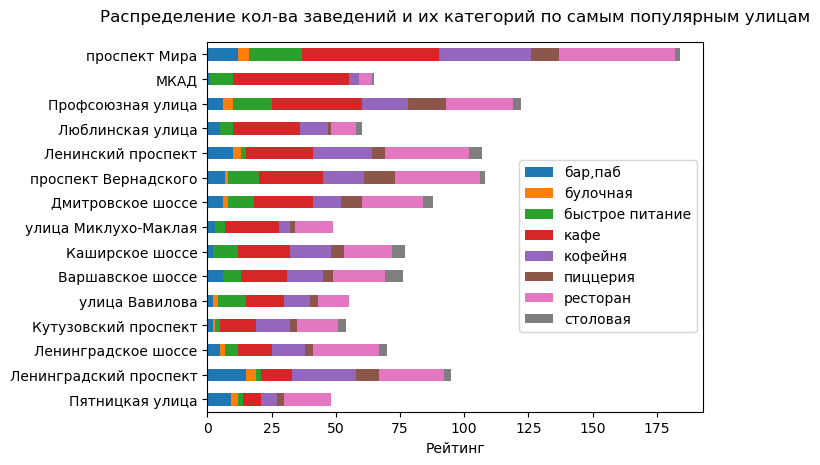

In [41]:
tfs_pivot.plot(kind = 'barh', stacked = True)

plt.legend(bbox_to_anchor=(1, 0.7)) # местоположение легенды

plt.title('Распределение кол-ва заведений и их категорий по самым популярным улицам',pad=15)
plt.xlabel('Рейтинг')
plt.ylabel('')

plt.show()

- Самое большое кол-во заведений на проспекте Мира
- Далее Профсоюзная ул, Пр-т Вернадского, Ленинский и Ленинградский пр-ты
- Кафе, Кофейни и Рестораны, почти везде в лидерах 

### 4.11 Посмотрим, есть-ли  улицы, на которых находится только один объект общепита:

In [42]:
df_grouped_by_street = df.groupby('street').count()
streets_with_one_place = df_grouped_by_street[df_grouped_by_street['name'] == 1].index
df[df['street'].isin(streets_with_one_place)].describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,458.000000,458.000000,458.000000,165.000000,24.000000,458.000000,156.000000
mean,55.760131,37.617146,4.236681,959.830303,186.166667,0.290393,59.115385
std,0.063903,0.093523,0.461952,999.518083,55.544472,0.454440,48.274880
min,55.578830,37.387459,1.000000,67.000000,95.000000,0.000000,0.000000
25%,55.729272,37.561486,4.100000,325.000000,140.000000,0.000000,30.000000
50%,55.760801,37.612995,4.300000,625.000000,177.500000,0.000000,45.000000
75%,55.795678,37.667302,4.500000,1250.000000,213.750000,1.000000,80.000000
max,55.914074,37.867004,5.000000,7000.000000,320.000000,1.000000,240.000000


In [43]:
# Добавим столбец для идентификации улиц с 1м объектом:
df['is_only_one'] = df['street'].isin(streets_with_one_place)

In [44]:
# Сравним улицы с 1м объектом с остальными:
df.groupby('is_only_one')[['rating','middle_avg_bill','middle_coffee_cup','chain','seats','is_24/7']].mean()

,rating,middle_avg_bill,middle_coffee_cup,chain,seats,is_24/7
is_only_one,,,,,,
False,4.229504,957.955429,174.183953,0.386512,110.079759,0.087947
True,4.236681,959.830303,186.166667,0.290393,59.115385,0.067686


- Особых закономерностей в заведениях с 1м объектом не найдено.
- При сравнении таких заведений с улицами где объектов много, также почти нет различий, за исключением:
    1. Сетей меньше на 10 %
    2. Кол-во мест в 2 раза меньше
    3. На 20% меньше заведений работают Круглосуточно

### 4.12 Анализ цен по районам:
Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. 
- Посчитаем медиану этого столбца для каждого района. Используем это значение в качестве ценового индикатора района.
- Построим фоновую картограмму (хороплет) с полученными значениями для каждого района. 
- Проанализируем цены в центральном административном округе и других. 

In [45]:
district_median_price= df.groupby('district', as_index=False)['middle_avg_bill'] \
    .median().sort_values(by='middle_avg_bill',ascending=False)
district_median_price

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [46]:
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=district_median_price,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Медианный Средний чек заведений по районам',
).add_to(m)

# выводим карту
m

### Общий вывод по результатам Анализа : 
Всего представлено 8406 объектов общественного питания 8ми типов:  
   'кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб', быстрое питание', 'булочная', 'столовая'
 
1. ТОП-3 по кол-ву с долей 60% от всех заведений: Кафе, рестораны и Кофейни 
2. ТОП-3 по медианному кол-ву посадочных мест: Рестораны(86), Бары/Пабы(82.5) и Кофейни(80)
3. ТОП-3 Категории с наибольшей долей сетей: Булочная(60%), Пиццерии(52%) и Кофейни(51%)
4. ТОП-15 популярных сетей в основном представлены в категориях Кафе и Быстрое питание
  * Средний чек в сетях ниже ~ на 35%
  * Средний рейтинг в сетях чуть ниже ~ на 0.2 балла
5. Средний рейтинг по категориям отличается не сильно, наиболее низкий у Кафе и быстрого питания
6. Самый популярный округ по кол-ву заведений:
    * Лидер - Центральный округ,
    * следом Северый, Южный и Северо-Восточный 
7. Наиболее популярные по кол-ву заведений улицы: 
    *  Самое большое кол-во заведений на проспекте Мира
    *  Далее Профсоюзная ул, Пр-т Вернадского, Ленинский и Ленинградский пр-ты
8. При сравнении улиц где только 1 объект с улицами где объектов много, выявлено несколько отличий:
    * Сетей меньше на 10 %
    * Кол-во мест в 2 раза меньше
    * На 20% меньше заведений работают Круглосуточно
9. При анализе среднего чека по районам выявлено:
    * ЦАО и ЗАО - самый высокий ср чек ~ 1000р 
    * В направлении Севера и Юга от центра - ср чек ~ на 30% ниже 
    * К Востоку от центра, ср чек опускается в 2 раза и ниже ~ до 500р
    
При обзоре общих данных Кофейня выглядит достаточно конкурентноспособным объектом.
    




<a id="details"></a>
## 5. Детализируем исследование: открытие кофейни
Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуем определить, осуществима ли мечта клиентов.

Ответим на следующие вопросы:

### 5.1 Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [47]:
# Выделим кофейни в отдельный df:
df_coffee_house = df[df['category'] == 'кофейня']

# Посчитаем кол-во кофеен:
print('Кол-во кофеен в датасете =', df_coffee_house['name'].count())

Кол-во кофеен в датасете = 1413


In [48]:
# Посмотрим кол-во кофеен по районам:
df_coffee_house.groupby('district', as_index=False)['name'].count().sort_values(by='name',ascending=False)

,district,name
5,Центральный административный округ,428
2,Северный административный округ,193
3,Северо-Восточный административный округ,159
1,Западный административный округ,150
8,Южный административный округ,131
0,Восточный административный округ,105
7,Юго-Западный административный округ,96
6,Юго-Восточный административный округ,89
4,Северо-Западный административный округ,62


In [49]:
# Для изучения особенностей расположения создадим карту с кофейнями:
m1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m1)

df_coffee_house.apply(create_clusters, axis=1)
m1

### 5.2 Есть ли круглосуточные кофейни?

In [50]:
dch = df_coffee_house.groupby('is_24/7',as_index=False)['is_24/7'].count()
dch

,is_24/7
0,1354
1,59


In [51]:
fig = go.Figure(data=[go.Pie(labels=dch.index, values=dch['is_24/7'])])
fig.update_layout(title_text='Доля кофеен работающих 24 часа', title_x=0.5, # Заголовок и его положение
                 autosize=False, width=800, height=400, # изменение размера графика
                 ) # изменение подписей легенды

fig.show() 

### 5.3 Какие у кофеен рейтинги? Как они распределяются по районам?

In [52]:
df_rating_by_district = (
    df_coffee_house.groupby('district',as_index=False)['rating'].mean().round(2)
    .sort_values(by='rating', ascending=False)
    .reset_index(drop=True)
)
df_rating_by_district

,district,rating
0,Центральный административный округ,4.34
1,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
3,Восточный административный округ,4.28
4,Юго-Западный административный округ,4.28
5,Юго-Восточный административный округ,4.23
6,Южный административный округ,4.23
7,Северо-Восточный административный округ,4.22
8,Западный административный округ,4.20


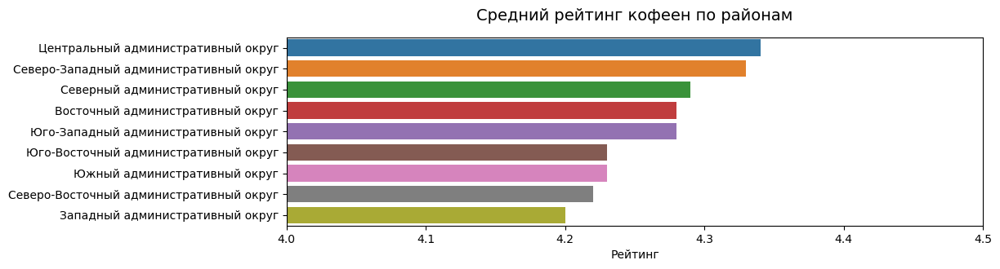

In [53]:
plt.figure(figsize=(11,3))
sns.barplot(data=df_rating_by_district, x='rating',y='district',orient='h')

plt.xticks(rotation=0) # наклон подписи оси x
plt.xlim(4,4.5)

plt.title('Средний рейтинг кофеен по районам', pad=15, fontsize=14)
plt.xlabel('Рейтинг')
plt.ylabel('')

plt.show()

### 5.4 На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [54]:
cap_cup_mean_price = round(df_coffee_house['middle_coffee_cup'].mean(),0)
print(f'Средняя цена чашки Капучино в Мск = {cap_cup_mean_price}')

Средняя цена чашки Капучино в Мск = 175.0


In [55]:
cap_price_by_district = df_coffee_house.groupby('district',as_index=False)['middle_coffee_cup'].mean().round() \
    .sort_values(by='middle_coffee_cup',ascending=False)
cap_price_by_district

,district,middle_coffee_cup
1,Западный административный округ,190.0
5,Центральный административный округ,188.0
7,Юго-Западный административный округ,184.0
0,Восточный административный округ,174.0
2,Северный административный округ,166.0
4,Северо-Западный административный округ,166.0
3,Северо-Восточный административный округ,165.0
8,Южный административный округ,158.0
6,Юго-Восточный административный округ,151.0


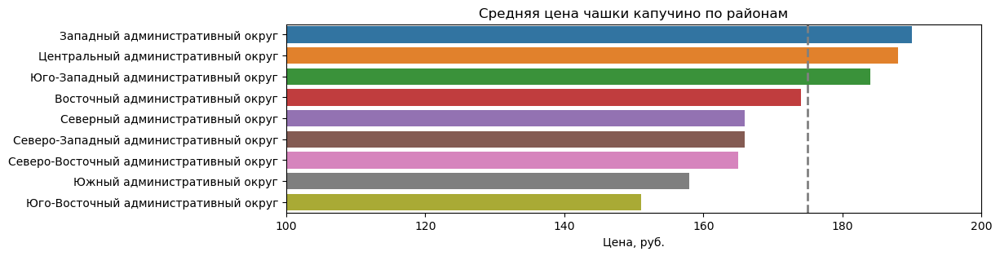

In [56]:
plt.figure(figsize=(11,3))
sns.barplot(data=cap_price_by_district, x='middle_coffee_cup',y='district',orient='h')

plt.xticks(rotation=0) # наклон подписи оси x
plt.xlim(100,200)
plt.axvline(color="grey",x= cap_cup_mean_price, linewidth= 2, linestyle="--") # ymin=0.25, ymax=0.75)

plt.title('Средняя цена чашки капучино по районам')
plt.xlabel('Цена, руб.')
plt.ylabel('')

plt.show()

<a id="recom"></a>
### Рекомендации: 

Для открытия кофейни и наиболее вероятной её финансовой успешности, исходя из имеющихся данных, предлагаю:
1. Выбрать район ЗАО или ЮЗАО, поскольку в них наименьшее кол-во кофеен и наибольший средний чек и стоимость чашки кофе
2. Рассмотреть улицы где уже есть несколько других объектов, но не кофеен.
3. Подобрать оптимальные часы работы, но не круглосуточные, тк доля таких всего 4% , явно не просто так.
4. Для более точно прогнозтварония успешности и фин стабильности кофейни, важно оценить данный анализ в связке с дополнительными параметрами, такими как: 
    * Стоимость аренды по районам/улицам 
    * Трафик по улицам 
    * Профили пользователей образующих трафик 
    


#### Сслыка на презентацию:   👇 👇 👇
 


https://drive.google.com/file/d/1bDwLJP4_y7EEMhtnGnlA6KkHz3vXKJF3/view?usp=sharing